In [3]:
import os
import cv2
from keras.preprocessing.image import ImageDataGenerator
import numpy as np
import matplotlib.pyplot as plt

In [4]:
#return augmented list
def preprocess_data(image_path, label):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (512, 512))
    
    datagen = ImageDataGenerator(
        rescale=1./255,
        rotation_range=20,
        shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True,
    )
    
    augmented_images = []
    
    # Include the original image
    augmented_images.append((img, label))
    
    for i in range (0,5):
        params = datagen.get_random_transform(img.shape)
        augmented_img = datagen.apply_transform(img, params)
        augmented_img = np.clip(augmented_img, 0, 255).astype(np.uint8)
        
        augmented_images.append((augmented_img, label))
        
    return augmented_images


In [5]:
def show_images(images):
    fig, axes = plt.subplots(1, len(images), figsize=(15, 5))

    for i, (img, label) in enumerate(images):
        axes[i].imshow(img)
        axes[i].set_title(f'Label: {label}')
        axes[i].axis('off')

    plt.show()

In [6]:
#Augmenting a single folder
augmented_images = [preprocess_data(os.path.join('Dataset\Chaar Narayan Temple\East', img), 1.01) for img in os.listdir('Dataset\Chaar Narayan Temple\East')]


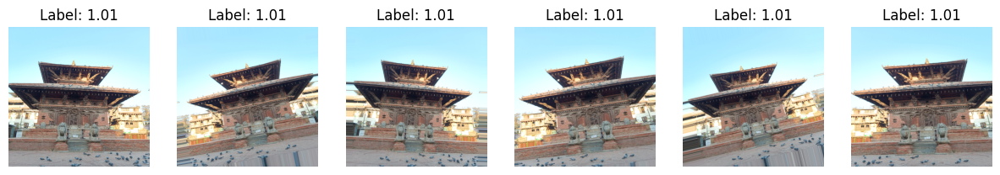

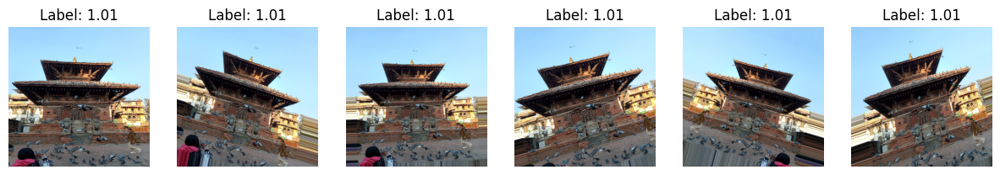

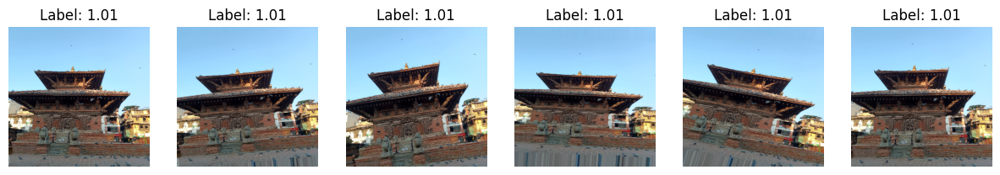

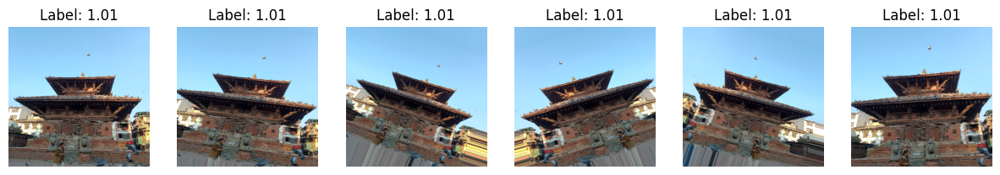

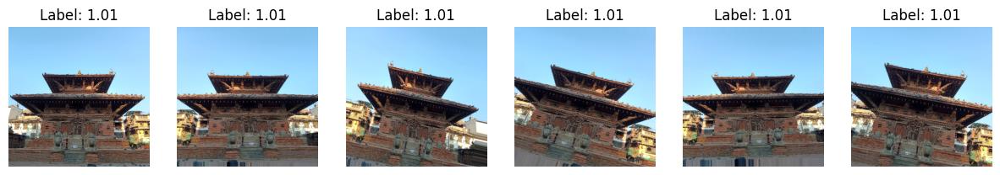

...

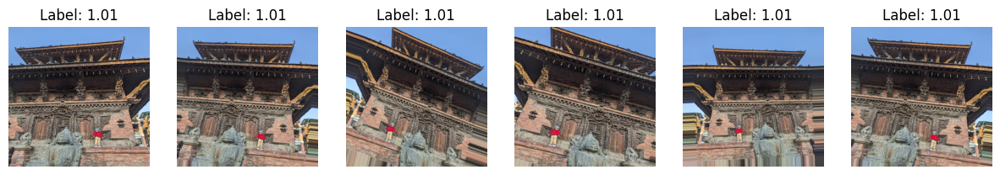

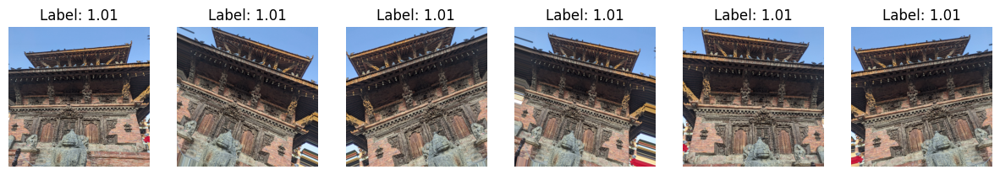

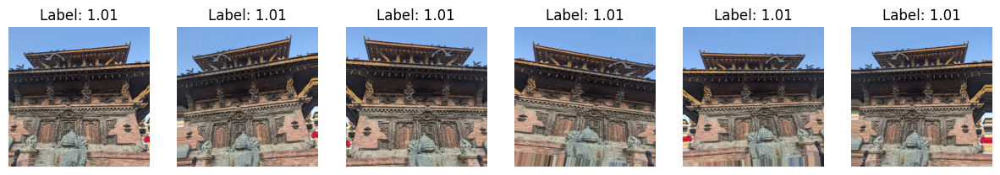

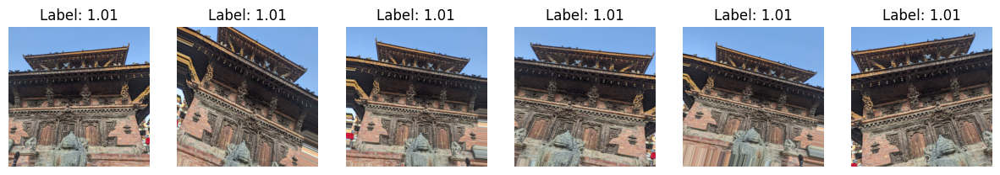

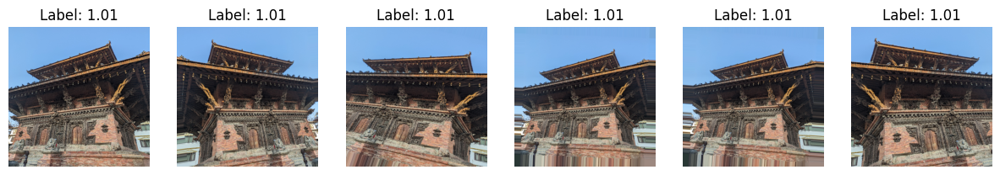

In [7]:
# Display augmented images from the directory
for images in augmented_images:
    show_images(images)